# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on the Celeb A dataset which is a large set of celebrity face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder

import numpy as np
import matplotlib.pyplot as plt
from gan.utils import show_images

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator

# Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

In [7]:
batch_size = 512
scale_size = 128  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [8]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

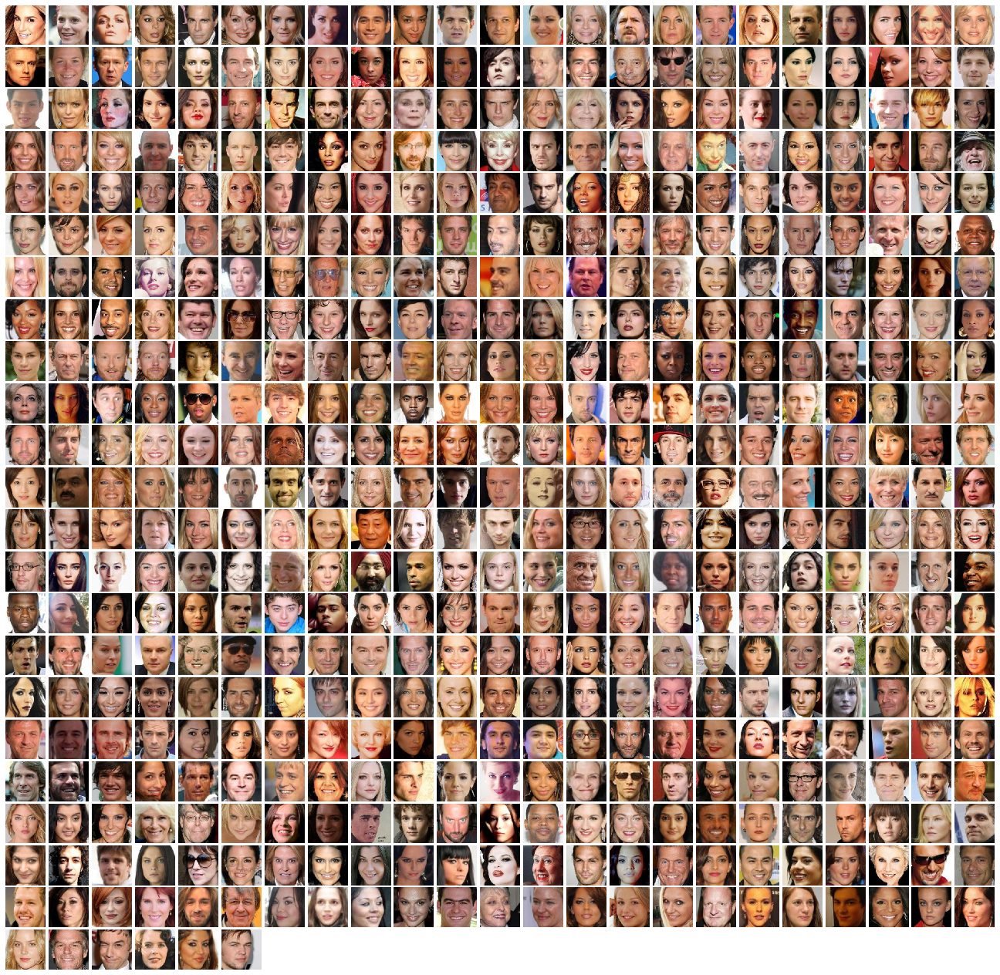

In [9]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [10]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0002

### Train GAN

In [11]:
# D = Discriminator().to(device)
# G = Generator(noise_dim=NOISE_DIM).to(device)

In [12]:
# D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
# G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [13]:
# original gan
# train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
#       generator_loss, num_epochs=NUM_EPOCHS, show_every=150, 
#       train_loader=celeba_loader_train, device=device)

### Train LS-GAN

In [14]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [15]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.4954, G:0.09502


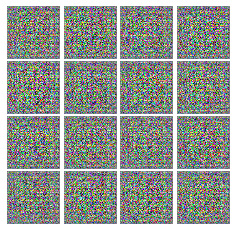


Iter: 100, D: 0.4057, G:0.2751


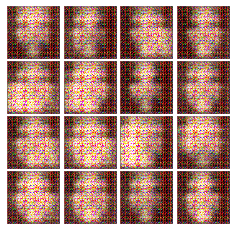


Iter: 200, D: 0.2712, G:0.1495


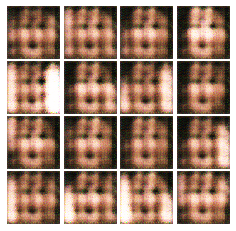


EPOCH:  2
Iter: 300, D: 0.2334, G:0.1943


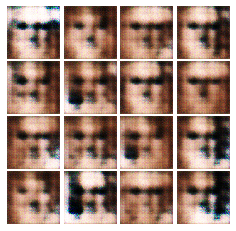


Iter: 400, D: 0.186, G:0.259


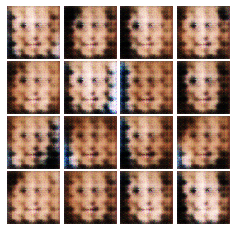


EPOCH:  3
Iter: 500, D: 0.24, G:0.1704


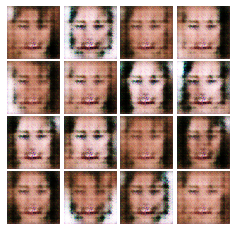


Iter: 600, D: 0.235, G:0.1429


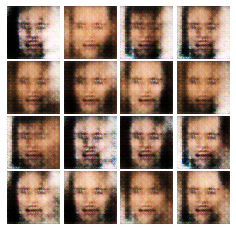


Iter: 700, D: 0.3856, G:0.2939


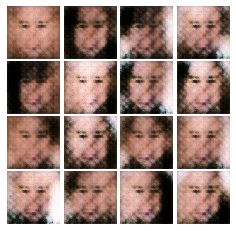


EPOCH:  4
Iter: 800, D: 0.2206, G:0.2096


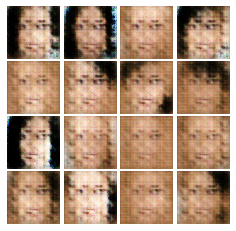


Iter: 900, D: 0.2331, G:0.3428


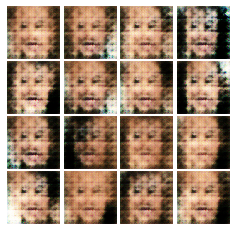


EPOCH:  5
Iter: 1000, D: 0.1425, G:0.329


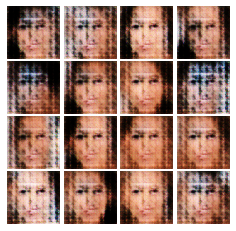


Iter: 1100, D: 0.1637, G:0.4146


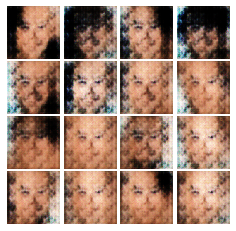


Iter: 1200, D: 0.1553, G:0.2591


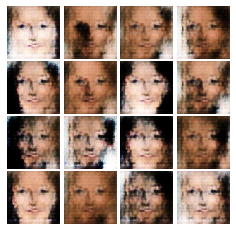


EPOCH:  6
Iter: 1300, D: 0.1879, G:0.4344


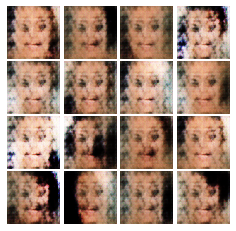


Iter: 1400, D: 0.1494, G:0.2944


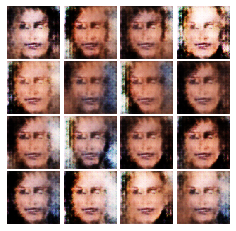


EPOCH:  7
Iter: 1500, D: 0.2111, G:0.3726


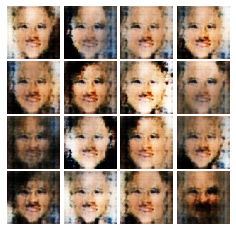


Iter: 1600, D: 0.2334, G:0.3116


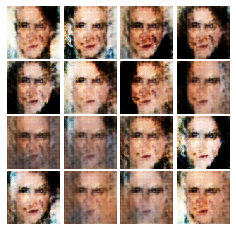


Iter: 1700, D: 0.17, G:0.3548


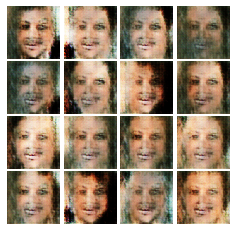


EPOCH:  8
Iter: 1800, D: 0.1613, G:0.4154


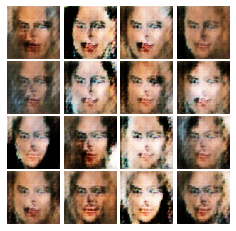


Iter: 1900, D: 0.1471, G:0.2846


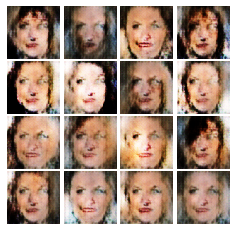


EPOCH:  9
Iter: 2000, D: 0.1358, G:0.3426


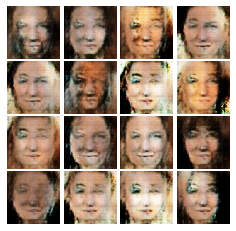


Iter: 2100, D: 0.1708, G:0.3373


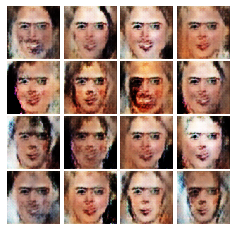


Iter: 2200, D: 0.1997, G:0.4648


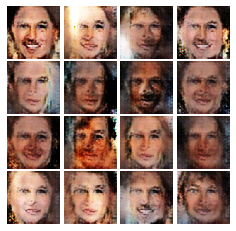


EPOCH:  10
Iter: 2300, D: 0.1728, G:0.2691


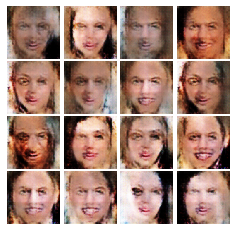


Iter: 2400, D: 0.1714, G:0.3245


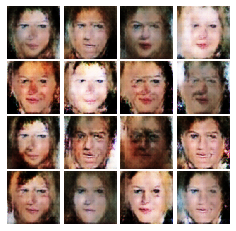


EPOCH:  11
Iter: 2500, D: 0.3461, G:0.4796


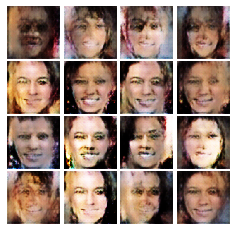


Iter: 2600, D: 0.1325, G:0.333


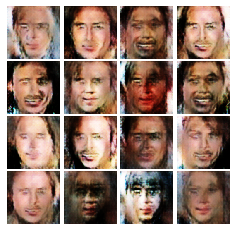


Iter: 2700, D: 0.1417, G:0.3095


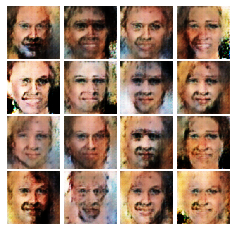


EPOCH:  12
Iter: 2800, D: 0.1605, G:0.3047


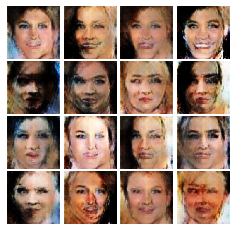


Iter: 2900, D: 0.1434, G:0.3686


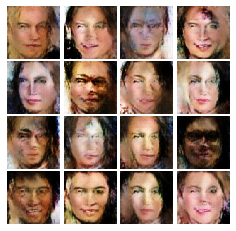


EPOCH:  13
Iter: 3000, D: 0.141, G:0.31


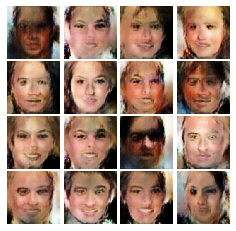


Iter: 3100, D: 0.1748, G:0.4409


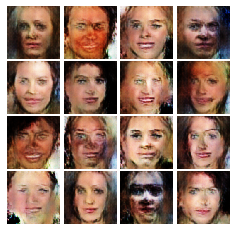


EPOCH:  14
Iter: 3200, D: 0.1469, G:0.3947


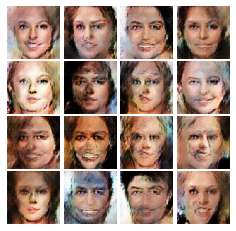


Iter: 3300, D: 0.1549, G:0.3075


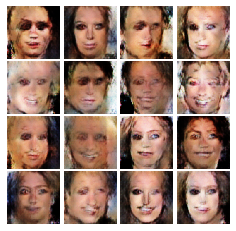


Iter: 3400, D: 0.1398, G:0.3338


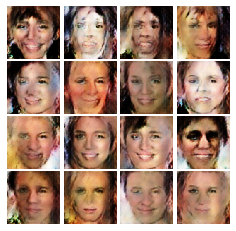


EPOCH:  15
Iter: 3500, D: 0.1844, G:0.5878


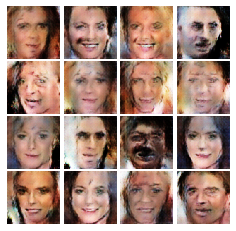


Iter: 3600, D: 0.127, G:0.276


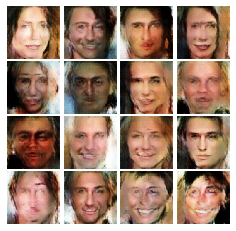


EPOCH:  16
Iter: 3700, D: 0.1178, G:0.4507


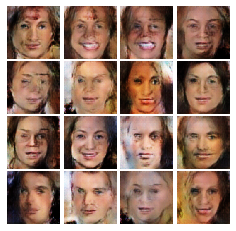


Iter: 3800, D: 0.1388, G:0.3706


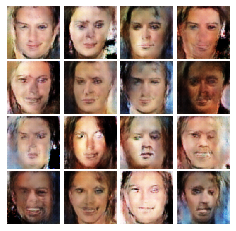


Iter: 3900, D: 0.1272, G:0.2939


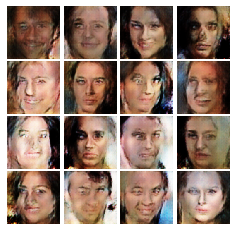


EPOCH:  17
Iter: 4000, D: 0.1507, G:0.3848


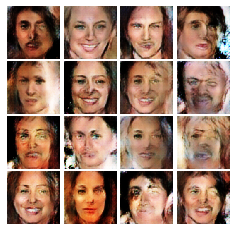


Iter: 4100, D: 0.1558, G:0.381


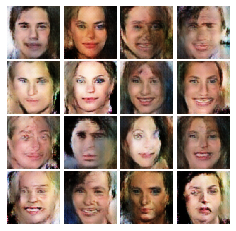


EPOCH:  18
Iter: 4200, D: 0.1501, G:0.4135


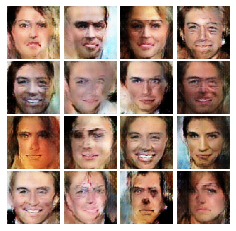


Iter: 4300, D: 0.1764, G:0.2653


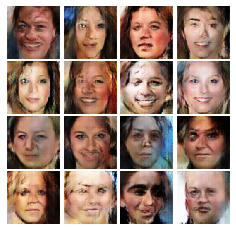


Iter: 4400, D: 0.3293, G:0.09723


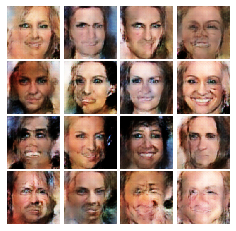


EPOCH:  19
Iter: 4500, D: 0.123, G:0.2806


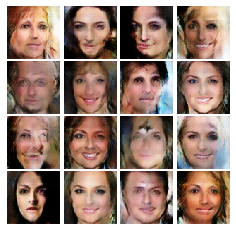


Iter: 4600, D: 0.1331, G:0.2966


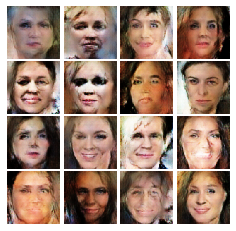


EPOCH:  20
Iter: 4700, D: 0.1313, G:0.2884


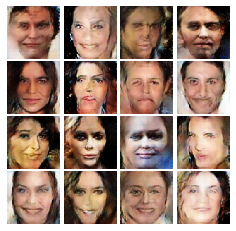


Iter: 4800, D: 0.1577, G:0.2953


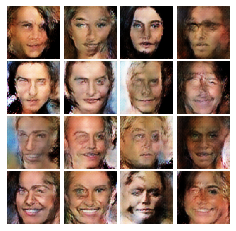


Iter: 4900, D: 0.1483, G:0.3793


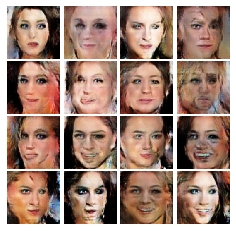


EPOCH:  21
Iter: 5000, D: 0.1681, G:0.2879


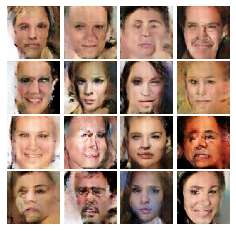


Iter: 5100, D: 0.186, G:0.2155


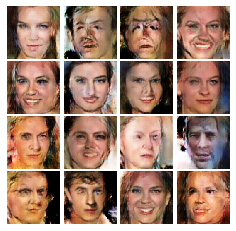


EPOCH:  22
Iter: 5200, D: 0.1605, G:0.1952


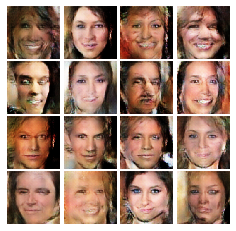


Iter: 5300, D: 0.1365, G:0.3246


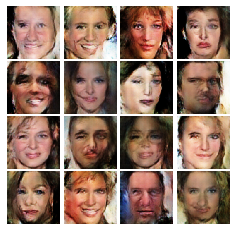


Iter: 5400, D: 0.1973, G:0.5446


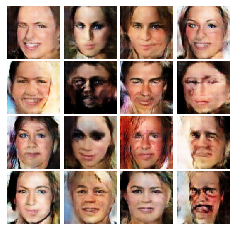


EPOCH:  23
Iter: 5500, D: 0.1591, G:0.2424


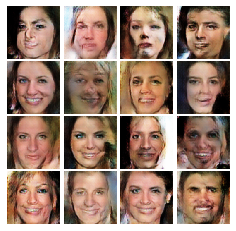


Iter: 5600, D: 0.1733, G:0.3085


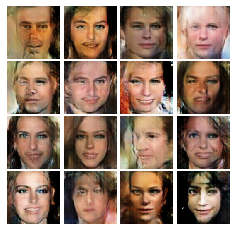


EPOCH:  24
Iter: 5700, D: 0.1691, G:0.2641


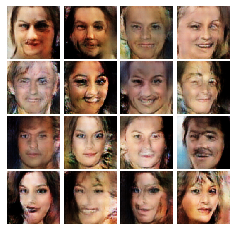


Iter: 5800, D: 0.1693, G:0.2191


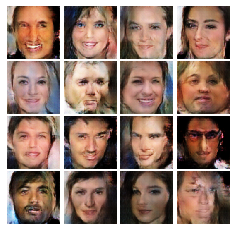


Iter: 5900, D: 0.1854, G:0.1581


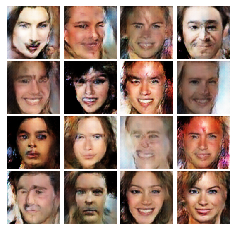


EPOCH:  25
Iter: 6000, D: 0.1701, G:0.3569


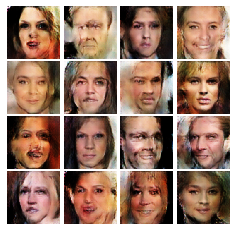


Iter: 6100, D: 0.1558, G:0.2751


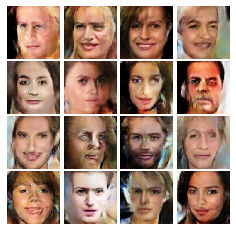


EPOCH:  26
Iter: 6200, D: 0.1735, G:0.3102


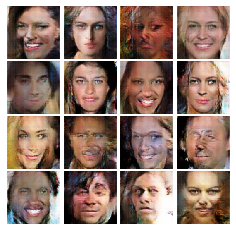


Iter: 6300, D: 0.1514, G:0.3763


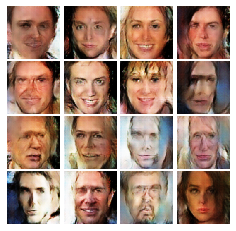


EPOCH:  27
Iter: 6400, D: 0.3217, G:0.1849


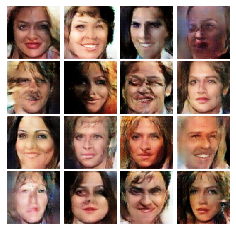


Iter: 6500, D: 0.2054, G:0.3117


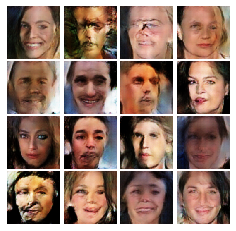


Iter: 6600, D: 0.2075, G:0.2756


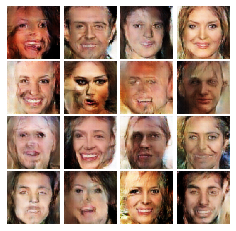


EPOCH:  28
Iter: 6700, D: 0.1308, G:0.314


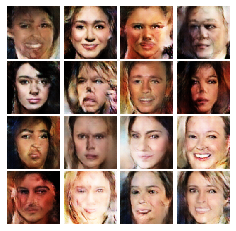


Iter: 6800, D: 0.1647, G:0.3019


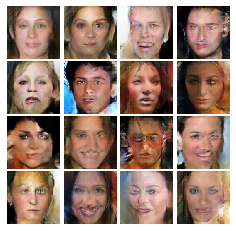


EPOCH:  29
Iter: 6900, D: 0.1692, G:0.4444


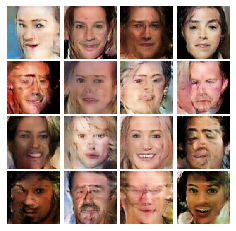


Iter: 7000, D: 0.1439, G:0.329


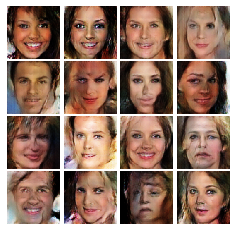


Iter: 7100, D: 0.1768, G:0.2506


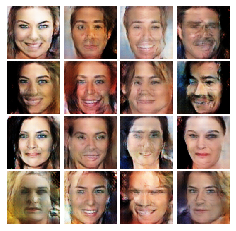


EPOCH:  30
Iter: 7200, D: 0.172, G:0.2558


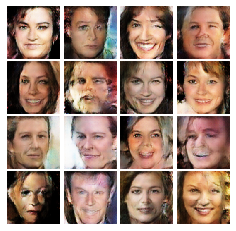


Iter: 7300, D: 0.1605, G:0.2931


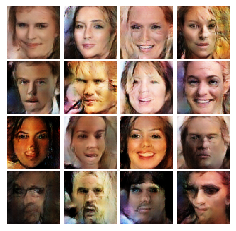


EPOCH:  31
Iter: 7400, D: 0.145, G:0.4712


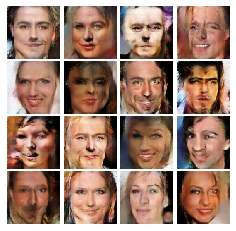


Iter: 7500, D: 0.1684, G:0.4847


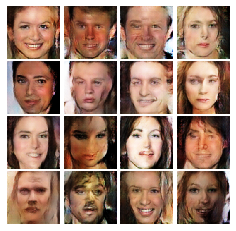


Iter: 7600, D: 0.1049, G:0.2822


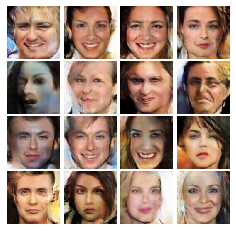


EPOCH:  32
Iter: 7700, D: 0.1605, G:0.2782


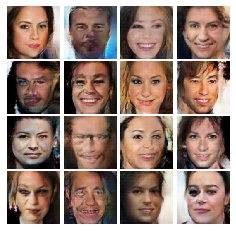


Iter: 7800, D: 0.1795, G:0.2415


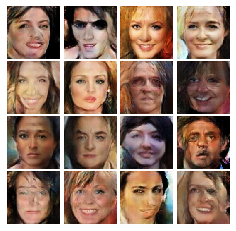


EPOCH:  33
Iter: 7900, D: 0.1589, G:0.2609


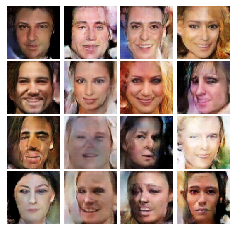


Iter: 8000, D: 0.17, G:0.2477


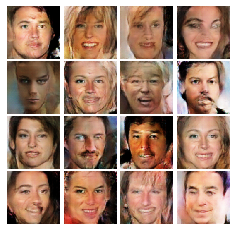


Iter: 8100, D: 0.1489, G:0.2924


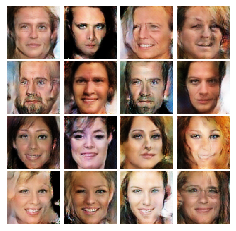


EPOCH:  34
Iter: 8200, D: 0.1799, G:0.2115


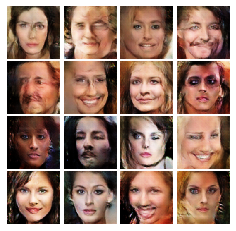


Iter: 8300, D: 0.1649, G:0.3186


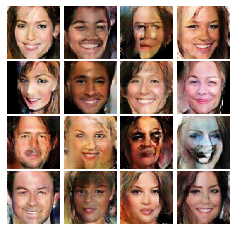


EPOCH:  35
Iter: 8400, D: 0.1596, G:0.2393


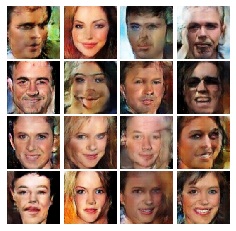


Iter: 8500, D: 0.1525, G:0.1921


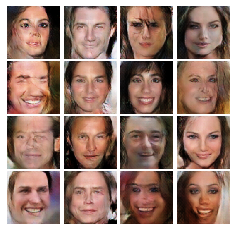


Iter: 8600, D: 0.1687, G:0.2677


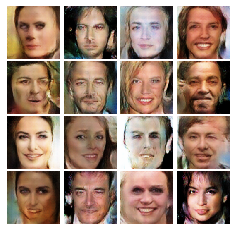


EPOCH:  36
Iter: 8700, D: 0.2008, G:0.1822


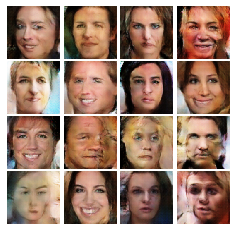


Iter: 8800, D: 0.6781, G:0.4446


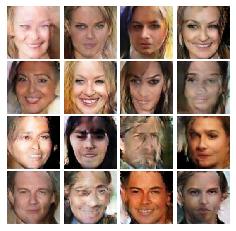


EPOCH:  37
Iter: 8900, D: 0.1757, G:0.43


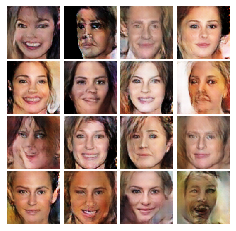


Iter: 9000, D: 0.1668, G:0.2408


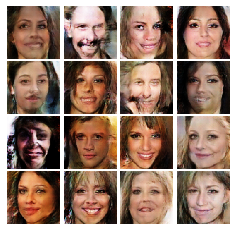


Iter: 9100, D: 0.1736, G:0.1829


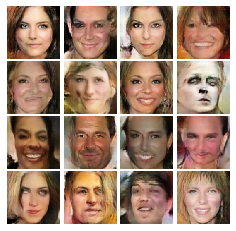


EPOCH:  38
Iter: 9200, D: 0.1688, G:0.386


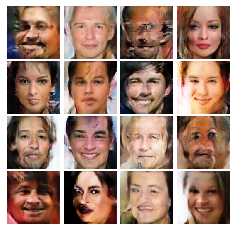


Iter: 9300, D: 0.1703, G:0.2574


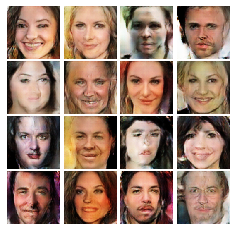


EPOCH:  39
Iter: 9400, D: 0.1862, G:0.2306


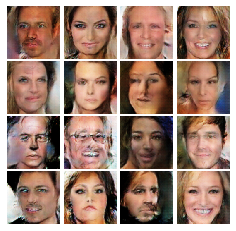


Iter: 9500, D: 0.1466, G:0.1867


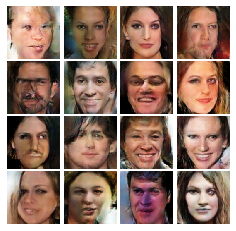


EPOCH:  40
Iter: 9600, D: 0.1557, G:0.2072


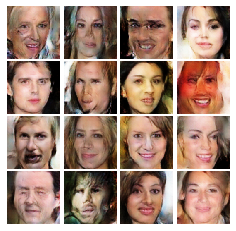


Iter: 9700, D: 0.1452, G:0.343


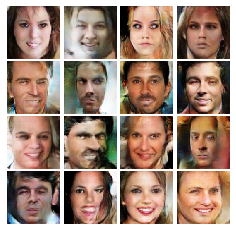


Iter: 9800, D: 0.1576, G:0.2625


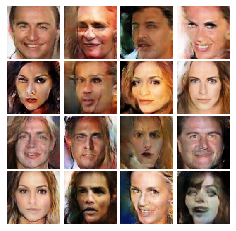


EPOCH:  41
Iter: 9900, D: 0.1938, G:0.2976


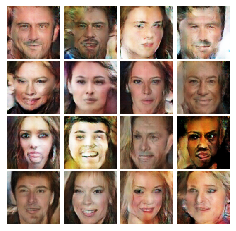


Iter: 10000, D: 0.1563, G:0.3163


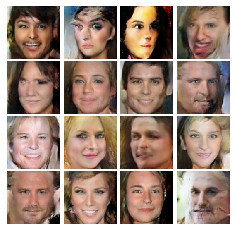


EPOCH:  42
Iter: 10100, D: 0.1459, G:0.2626


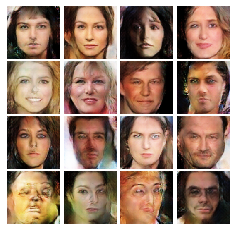


Iter: 10200, D: 0.1706, G:0.3616


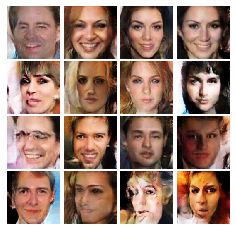


Iter: 10300, D: 0.145, G:0.3992


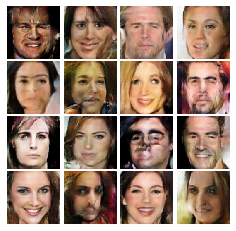


EPOCH:  43
Iter: 10400, D: 0.1681, G:0.2587


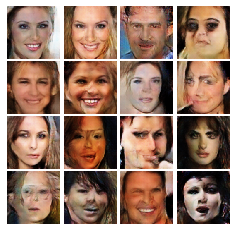


Iter: 10500, D: 0.1411, G:0.2964


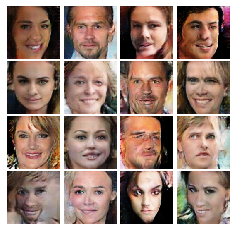


EPOCH:  44
Iter: 10600, D: 0.1487, G:0.3247


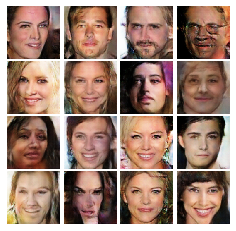


Iter: 10700, D: 0.1693, G:0.2098


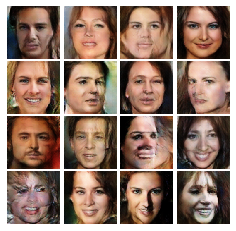


Iter: 10800, D: 0.1496, G:0.3812


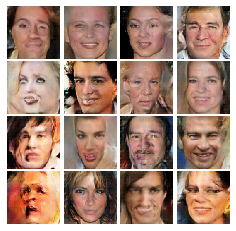


EPOCH:  45
Iter: 10900, D: 0.1821, G:0.4392


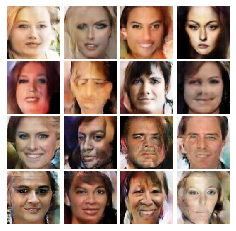


Iter: 11000, D: 0.1526, G:0.5124


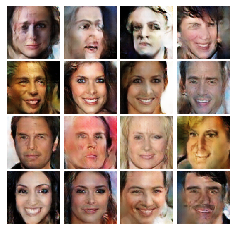


EPOCH:  46
Iter: 11100, D: 0.167, G:0.243


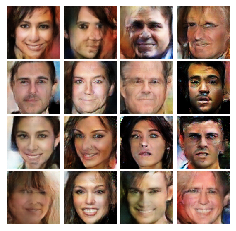


Iter: 11200, D: 0.1771, G:0.2619


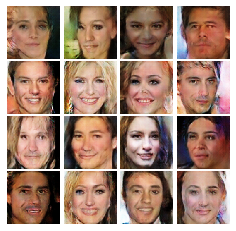


Iter: 11300, D: 0.1792, G:0.3423


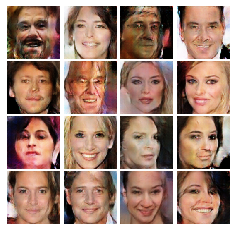


EPOCH:  47
Iter: 11400, D: 0.1496, G:0.2986


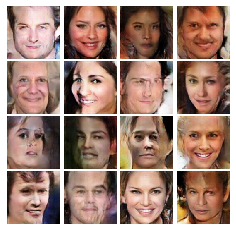


Iter: 11500, D: 0.1374, G:0.3173


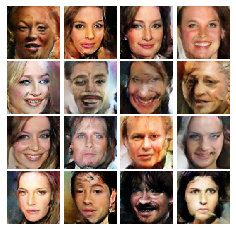


EPOCH:  48
Iter: 11600, D: 0.1581, G:0.2285


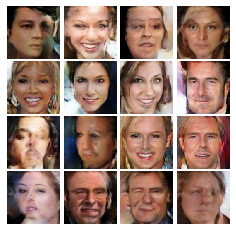


Iter: 11700, D: 0.168, G:0.3213


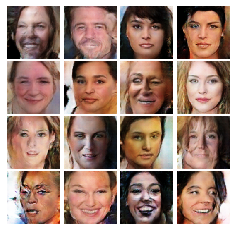


Iter: 11800, D: 0.1377, G:0.3129


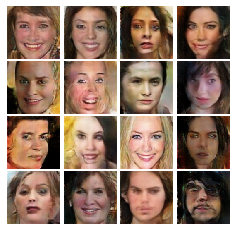


EPOCH:  49
Iter: 11900, D: 0.158, G:0.3566


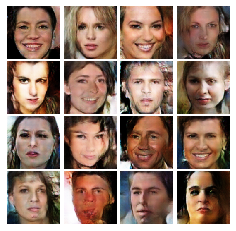


Iter: 12000, D: 0.1364, G:0.2477


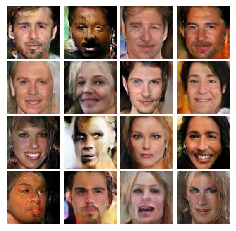


EPOCH:  50
Iter: 12100, D: 0.1469, G:0.3477


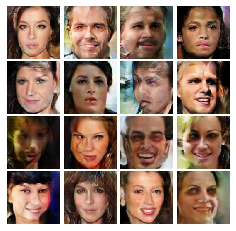


Iter: 12200, D: 0.1681, G:0.2118


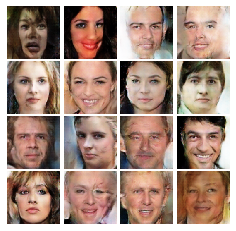

In [16]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
      ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=100,
      train_loader=celeba_loader_train, device=device)